## The Travelling Salesman Problem 

This notebook contains different local search methods to solve the classic travelling salesman problem. There are many ways to formulate the problem, including Dantzig, Fulkerson, and Johnson's famous MIP formulation. However, the problem is defined here more simply as follows:

- let $N$ be the set locations $0,..., n-1$ with coordinates $(x_i, y_i) \in N$
- let $v_i \; \; i \in N$ be variable denoting the visitation order of the locations, i.e. the value of $v_i$ is the $i^{th}$ location to be visited
- let $d(l_1, l_2)$ denotes the cost of travelling between the two locations. The cost used here is the Euclidean distance

The goal is minimise the length of a Hamiltonian cycle of the graph. A simple formalisation of the problem is then: 
<br>
<br>
<br>
$$\begin{alignat}{3}
\text{minimse: }        &\quad&  \sum_{i \in N} d(v_i, v_{i+1}) + d(v_{n-1}, v_{0})  &&          & \\
\text{subject to: }        &\quad&  v_i \; are\: a \:permutation \:of\; N  &&          & \\
\end{alignat}\\
$$
<br>
<br>

The algorithms implemented to solve the problem are:
- the nearest neighbour heuristic (to arrive at an initial solution)
- an iterated, greedy 2-opt swap 
- simulated annnealing

In [1]:
from initial_solutions import NearestNeighbour
from search_methods import IteratedTwoOpt, SimulatedAnnealing, greedy_two_opt
from problem_setup import *

In [2]:
with open('data\\tsp_51_1', 'r') as input_data_file:
    input_data = input_data_file.read()

### Nearest Neighbour Heuristic

The nearest neighbour heuristic is a simple greedy algorithm commonly used to find an initial solution to the TSP, which can then be improved using neighbourhood search methods.

The algorithm requires the choice of a city to start at, here I've just chosen a city at random. The next city on the tour is simply selected as the closest unvisted city. This process is repeated until all cities have been visited and, in this case, a Hamiltonian cycle of the graph is complete.

In [3]:
nn = NearestNeighbour(input_data)
nn.nn_initial_solution(starting_node=0)
print("The tour has a length of {:.2f}".format(nn.obj_value))

The tour has a length of 587.15


The algorithm produces the following tour, which can quite clearly be identified as suboptimal due to the numerous crossing edges. 

C:\ProgramData\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



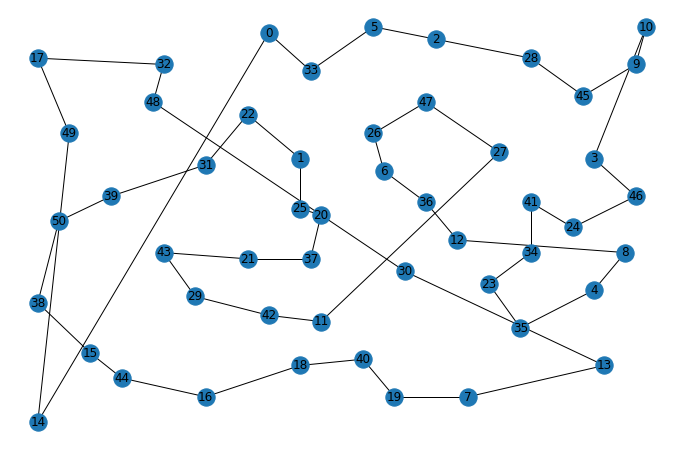

In [4]:
nn.plot_tour()

### Iterated Greedy 2-Opt Swap 

The initial solution can then be improved by searching the neighbourhood of potential moves and choosing one that reducing the length of the tour. 

One method is called a 2-opt swap. This involves removing two edges and reconnecting them to alter the tour slightly. Given a tour 1 - 2 - 3 - 4 - 5 - 6 - 7, with a 2-opt swap edges (1, 2) and (5, 6) become (1, 5) and (2, 6). The resulting tour is then 1 - 5 - 4 - 3 - 2 - 6 - 7.

This algorithm performs such swaps for one city with each of the $k$ preceding and $k$ following cities in the tour. It then implements the swap that leads to the greatest improvement. This is done for each city in the tour, choosing the best swap each time. The whole process is then repeated until there are no further improvements between iterations. 

As can be seen on the interactive chart below, the algorithm quickly reaches a solution. The solution here is, however, almost always a local optimum. Thus more sophisticated search heuristics are needed to escape the local minimum and improve upon the  solution. 

In [5]:
%%time
two_opt = IteratedTwoOpt(input_data)
two_opt.generate_initial_solution(initial_solution='nearest neighbour')
two_opt.search(k=15, max_iterations=10)
print("The tour has a length of {:.2f}".format(two_opt.obj_value))

The tour has a length of 455.18
Wall time: 82.8 ms


In [6]:
calculate_tour_length(two_opt.tour, two_opt.coordinates, two_opt.node_count)

455.18375711644023

In [7]:
two_opt.plot_objective_value()

### Simulated Annealing

Simulated annealing is a probabilistic metaheuristic used to search for the optimum of a given function. It is inspired by the annealing in metallurgy, which involves the heating and controlled cooling of a material to increase the size of its crystals and reduce their defects. The cooling in simulated annealing refers to the decreasing probability of accepting a worse solution as the solution space is explored.

At each iteration, the algorithm randomly generates a potential next state. The transition to this state is dictated by the  acceptance probability $e^{-{\Delta f}/T}$. Where:
- $\Delta f$ is the difference in the objective function between the current state and the neighbouring state
- $T$ is the current temperature of the system
- $e$ is Euler's number

After each iteration the temperature $T$ is updated as $T_{k+1} = \alpha T_k$. Thus, there are a number of parameters to be selected for the algorithm. Namely:
- an initial temperature $T_0$
- the cooling rate $\alpha \in (0,1)$

It is important that the temperature be large enough to allow for the whole solution space to be searched in the early stages and that the cooling rate be such that the system doesn't cool down too quickly before a good solution can be found. 

Simulated annealing can accept a worse move at each iteration according to some probability, as such, it is possible that the algorithm finds a good solution but then gets stuck exploring a part of the solution space without any improvement. To counteract this, I have implemented a 'reset' function. This is activated if there has been no improvement on the current best solution for a certain period of time. Should this be the case, the algorithm reverts back to the current best tour and continues the search from there. This functionality led to a better directed search and improved results.

On many problems in the data folder, this implementation of the algorithm is often able to locate the global optimum. Examples of this are:
- problem 51_1 - optimal tour length 428.87
- problem 100_3 - optimal tour length 21750.76

In [11]:
%%time
sim = SimulatedAnnealing(input_data)
sim.generate_initial_solution(initial_solution='nearest neighbour')
sim.search(cooling_rate=0.00002)
print("After {:,.0f} iterations, the shortest tour found was one with a length of {:.2f}".format(
    sim.search_iterations,sim.obj_value))

After 448,986 iterations, the shortest tour found was one with a length of 428.87
Wall time: 11.4 s


In [12]:
sim.plot_objective_value()

The resulting tour is one that is a huge improvement on the tour generated by the nearest neighbour heuristic.

C:\ProgramData\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



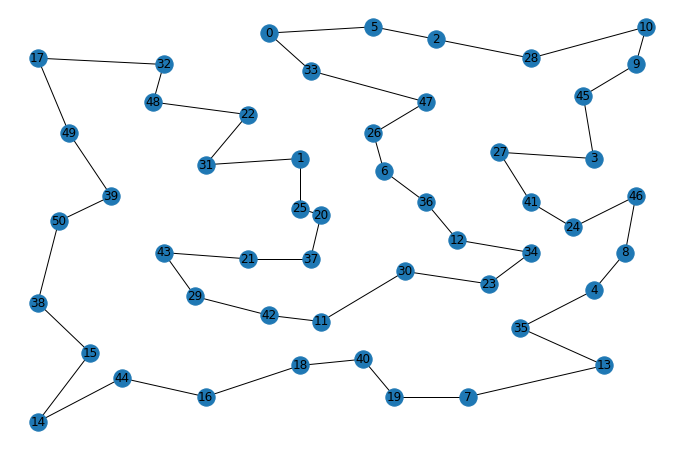

In [10]:
sim.plot_tour()